In [2]:
import os

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import IPython.display as ipd

from dotenv import load_dotenv
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import calinski_harabasz_score, silhouette_score, davies_bouldin_score, pairwise_distances, v_measure_score

sns.set_style("whitegrid")
sns.set_palette("Set2")
load_dotenv()

True

# 1. Defining the task
In this lab we will try to cluster the tracks using their audio features, and try to determine whether there are underlying patterns between tracks from similar genres. It wouldn't be surprising if we observe tracks with significantly "different" features being classified in the same genre, since the genres are chosen by the artists themselves. It is possible that artists may deliberately misclassify the genre in which a track belongs to, for personal benefits.
We will perform clustering using the K-Means algorithm, a Gausian Mixture model, as well as hierarchical clustering, and compare the results.

In [2]:
df = pd.read_csv(os.getenv("FEATURES_PATH_PROCESSED"), index_col=0, header=[0, 1, 2])
# Genre column has no inner levels
df = df.rename(columns={'Unnamed: 253_level_1': '', 'Unnamed: 253_level_2' : ''})
genres = df['genre']

# We select only spectral_centroid because of the high correlation with spectral_bandwidth and spectral_rolloff
slice_1 = pd.IndexSlice[['mfcc', 'spectral_centroid', 'spectral_contrast', 'rmse', 'tonnetz', 'zcr']]

# Select all features of chroma_cqt, except max (most of the values are 1s)
slice_2 = pd.IndexSlice['chroma_cqt', ('kurtosis', 'mean', 'median', 'min', 'skew', 'std')]
df = pd.concat([df.loc[:, slice_1], df.loc[:, slice_2]], axis=1).copy()

Subsampling to reduce execution time (in the final project, the whole dataset will be used)

In [3]:
df, _, genres, _ = train_test_split(df, genres, stratify=genres, train_size=0.6, random_state=31)

Scaling the data

In [4]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

df_normalized = pd.DataFrame(MinMaxScaler().fit_transform(df), index=df.index, columns=df.columns)
df_standardized = pd.DataFrame(StandardScaler().fit_transform(df), index=df.index, columns=df.columns)

Defining functions that we will use later

In [5]:
def plot_in_2d(df, clusters, title='Labeled clusters on the first two principal components'):
    pca = PCA(n_components=2)
    df = pd.DataFrame(pca.fit_transform(df), columns=['pc1', 'pc2'], index=df.index)

    fig, axs = plt.subplots(1, 2, figsize=(25, 8))
    fig.suptitle(title)
    sns.scatterplot(data=df.join(clusters, on='track_id', how='inner'), x='pc1', y='pc2', hue='clusters', palette='rainbow', ax=axs[0],)
    sns.kdeplot(data=df.join(clusters, on='track_id', how='inner'), x='pc1', y='pc2', hue='clusters', palette='rainbow', ax=axs[1])
    plt.show()

def plot_indices(results_dict):
    _, axs = plt.subplots(1, 3, figsize=(25, 5))

    cols_labels = [('CH', 'Calinski Harabasz Index'), ('Silhouette', 'Silhouette Coefficient'), ('DB', 'Davies Bouldin Index')]
    for i, (key, title) in enumerate(cols_labels):
        sns.lineplot(data=results_dict[key], ax=axs[i])
        axs[i].set_title(title)

    plt.show()

# 2. K-Means++
From start, we speculate that K-Means may not be appropriate for this dataset, since it makes the following assumptions (if we interpret it in terms of a GMM, that uses a modified version of the EM algorithm):
- $\Sigma_c=\sigma^2\mathbf{\mathbb{I_{D}}}$ is fixed (assumption for spherical clusters of same size)
- $\pi_k=1/K$ is fixed (assumption that the prior probability of a point belonging to a cluster is uniform - which is probably not the case for our data)

Given the "dense" nature of our data, we chose to use Euclidean distance as a distance metric for the algorithm.

In [6]:
kmeans_results = {col: [] for col in ['num_clusters', 'CH', 'Silhouette', 'DB', 'SSE']}
kmeans_models = {}

for k in range(8, 18):
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=32)
    kmeans_models[k] = kmeans
    labels = pd.Series(kmeans.fit_predict(df_normalized), index=df_normalized.index)

    kmeans_results['num_clusters'].append(k)
    kmeans_results['CH'].append(calinski_harabasz_score(df_normalized, labels))
    kmeans_results['Silhouette'].append(silhouette_score(df_normalized, labels))
    kmeans_results['DB'].append(davies_bouldin_score(df_normalized, labels))
    kmeans_results['SSE'].append(kmeans.inertia_)


kmeans_results = pd.DataFrame(kmeans_results)
kmeans_results = kmeans_results.set_index('num_clusters')

- There is no elbow on the CH index; difficult to infer the optimal num_clusters
- The SH coefficient is close to 0, indicating that there are clusters that are probably overlapping
- The DB index suggests that 16 clusters is the optimal number of clusters (which is the same as the number of genres)

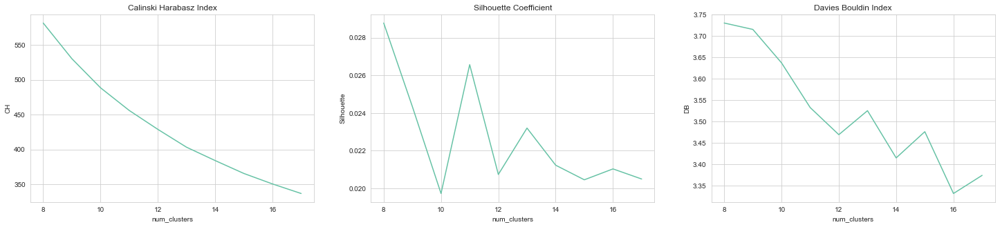

In [7]:
plot_indices(kmeans_results)

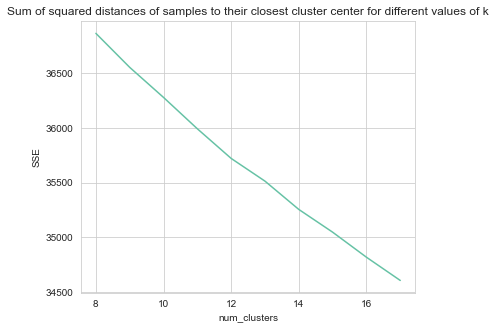

In [8]:
plt.figure(figsize=(6, 5))
sns.lineplot(data=kmeans_results['SSE'])
plt.title('Sum of squared distances of samples to their closest cluster center for different values of k')
plt.show()

In [9]:
k_means = kmeans_models[16]
clusters_kmeans = pd.Series(k_means.predict(df_normalized), index=df_normalized.index, name='clusters')

The different number of tracks per cluster is expected, considering the imbalanced classes in the dataset.

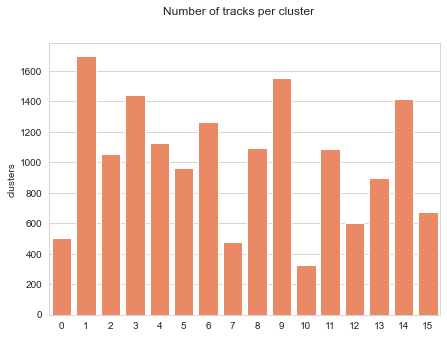

In [7]:
plt.figure(figsize=(7, 5))
sns.barplot(y=clusters_kmeans.value_counts(), x=clusters_kmeans.value_counts().index, orient='v', color='coral')
plt.suptitle('Number of tracks per cluster')
plt.show()

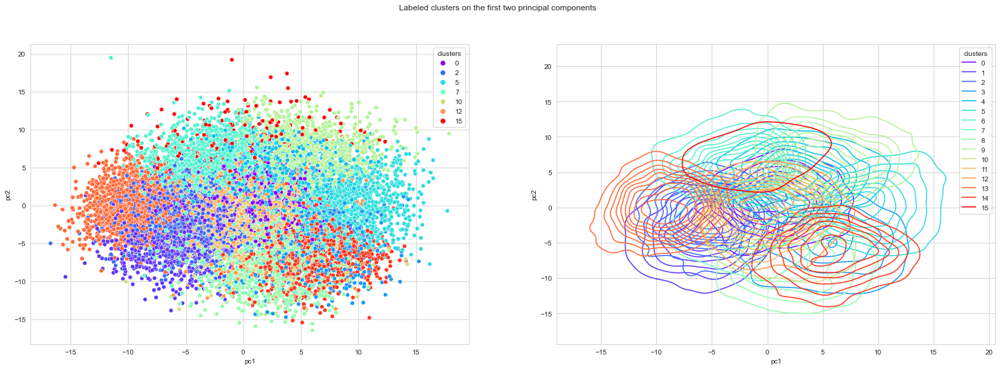

In [32]:
plot_in_2d(df_standardized, clusters_kmeans)

As a sanity check, we can randomly select two songs from clusters with distant centers and listen to them in order to determine if there is a notable difference between them.

In [9]:
df_kmeans = pd.concat([df_normalized, clusters_kmeans], axis=1)

In [10]:
distances = pairwise_distances(pd.DataFrame(k_means.cluster_centers_), metric='euclidean', n_jobs=-1)
np.unravel_index(distances.argmax(), distances.shape)

(6, 9)

In [25]:
track_id_1 = df_kmeans.query('clusters == 6').sample(1, random_state=321).index
track_id_2 = df_kmeans.query('clusters == 10').sample(1, random_state=321).index

In [29]:
# This is track_1
ipd.Audio('././audio/Nautical Almanac - pTak Vocdub.mp3')

In [30]:
# This is track_2
ipd.Audio('././audio/The Kyoto Connection - The best days of my life.mp3')

Although the optimal clustering results were achieved when using 16 clusters, which aligns with the number of top-level genres available, the assigned clusters do not align with the genre segmentation. This suggests that the correlation between the features is influenced by a latent variable other than the genre itself, meaning that it is possible to group certain songs together despite their varying genres.

In [33]:
print(f'V measure score for K-Means: {v_measure_score(genres, clusters_kmeans)}')

V measure score for K-Means: 0.15329908061348496


# 3. GMM

This approach for clustering fits a mixture model, assuming that the distribution $p(\mathbf{x}_i|\mathbf{\theta})$ could be represented as a convex combination of $K$ base distributions, in this case Gaussians. Judging by the results from the KMeans algorithm (and due to limitations in computing power), we only fit the models for 3 different values for $K$: 14, 15 and 16, using both full and tied covariance matrices for the base distributions in the mixture.
The models that assume shared covariance matrix between the components (between the clusters) have better BIC scores (which is expected, due to the smaller number of parameters that need to be estimated).
(Note that KMeans is essentially a GMM with tied diagonal covariance matrices, that uses a delta function to approximate the posterior probability of a point belonging to a cluster)

In [35]:
from sklearn.mixture import GaussianMixture

In [7]:
n_components_range = range(14, 17)
gmm_results = {col: [] for col in ['num_clusters', 'BIC', 'CV']}
gmm_models = {}
cv_types = ['tied', 'full']
for cv_type in cv_types:
    for n_components in n_components_range:
        gmm = GaussianMixture(n_components=n_components, covariance_type=cv_type, init_params='kmeans', random_state=32)
        gmm.fit(df_standardized)
        gmm_models[(n_components, cv_type)] = gmm

        gmm_results['num_clusters'].append(n_components)
        gmm_results['BIC'].append(gmm.bic(df_standardized))
        gmm_results['CV'].append(cv_type)

gmm_results = pd.DataFrame(gmm_results)

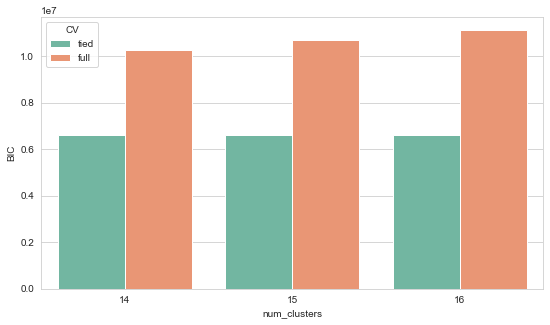

In [15]:
plt.figure(figsize=(9, 5))
sns.barplot(data=gmm_results, x='num_clusters', y='BIC', hue='CV')
plt.show()

In [9]:
gmm_results.sort_values(by='BIC', ascending=True).head(5)

,num_clusters,BIC,CV
2,16,6.590654e+06,tied
1,15,6.612909e+06,tied
0,14,6.616281e+06,tied
3,14,1.027129e+07,full
4,15,1.067368e+07,full


In [11]:
gmm = gmm_models[(16, 'tied')]
clusters_gmm = pd.Series(gmm.predict(df_standardized), index=df_standardized.index, name='clusters')

C:\Users\User\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\distributions.py:1210: UserWarning: No contour levels were found within the data range.
  cset = contour_func(


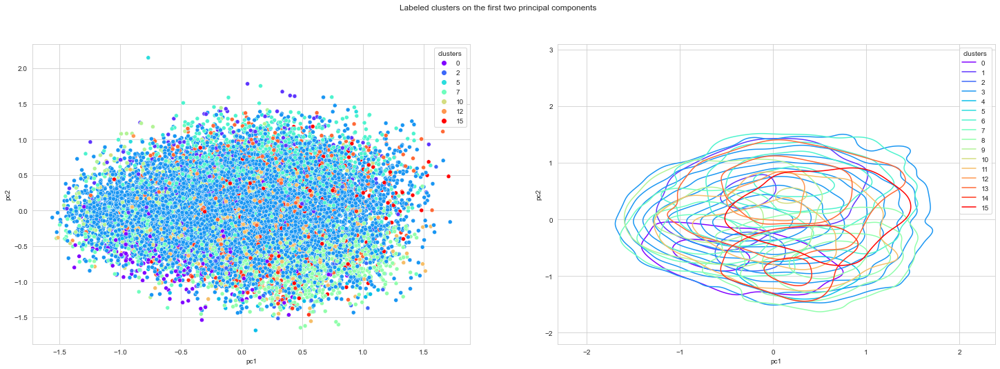

In [12]:
plot_in_2d(df_normalized, clusters_gmm)

We notice that most of the data got assigned to one cluster, and that some clusters contain very little data. This is a strong indicator that this clustering is not appropriate for the data.

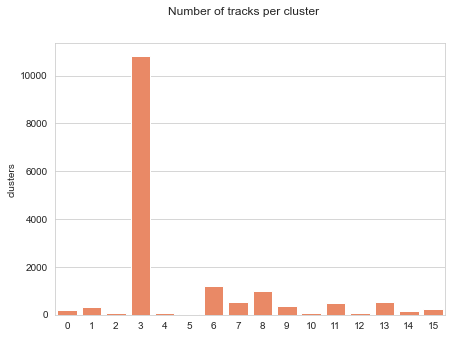

In [38]:
plt.figure(figsize=(7, 5))
sns.barplot(y=clusters_gmm.value_counts(), x=clusters_gmm.value_counts().index, orient='v', color='coral')
plt.suptitle('Number of tracks per cluster')
plt.show()

We observe similar outcomes to those of KMeans when it comes to the alignment of clusters with the genre of the tracks.

In [13]:
print(f'V measure score for K-Means: {v_measure_score(genres, clusters_gmm)}')

V measure score for K-Means: 0.11170576126224672


# 4. Hierarchical Clustering
This way of clustering is fundamentally different from the previous two, since it is hierarchical and not partitional.
We will use ward's method to define the distance metric between clusters, mainly because it can better handle outliers and clusters with varying densities.

In [41]:
from sklearn.cluster import AgglomerativeClustering

In [9]:
ac_results = {col: [] for col in ['num_clusters', 'CH', 'Silhouette', 'DB']}
ac_models = dict()

for i in range(8, 18):
    ac = AgglomerativeClustering(n_clusters=i, affinity='euclidean', linkage='ward')
    labels = pd.Series(ac.fit_predict(df_standardized), index=df_standardized.index)
    ac_models[i] = ac

    ac_results['num_clusters'].append(i)
    ac_results['CH'].append(calinski_harabasz_score(df_standardized, labels))
    ac_results['Silhouette'].append(silhouette_score(df_standardized, labels))
    ac_results['DB'].append(davies_bouldin_score(df_standardized, labels))

ac_results = pd.DataFrame(ac_results)
ac_results = ac_results.set_index('num_clusters')

In [36]:
ac_results.head(5)

,CH,Silhouette,DB
num_clusters,,,
8,337.214584,-0.001532,4.657351
9,310.674837,0.001035,4.518501
10,289.844873,0.001173,4.506399
11,272.022879,-0.002416,4.470072
12,255.921138,-0.006574,4.494726


A reasonable value for the number of clusters, according to the DB Index is 11.
(Despite the fact that these metrics may not be the most appropriate for evaluating this type of clustering)

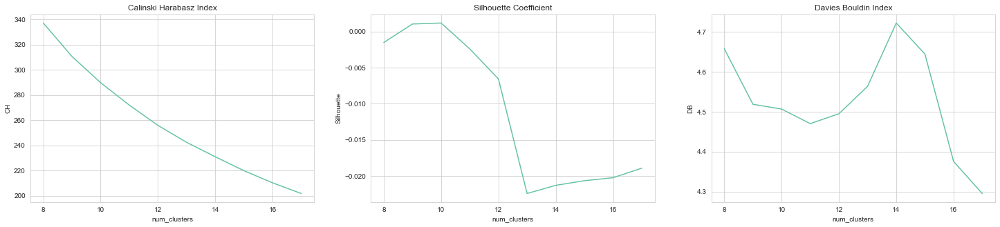

In [14]:
plot_indices(ac_results)

In [40]:
ac = ac_models[11]
clusters_ac = pd.Series(ac.labels_, name='clusters', index=df_standardized.index)

C:\Users\User\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\distributions.py:1210: UserWarning: No contour levels were found within the data range.
  cset = contour_func(


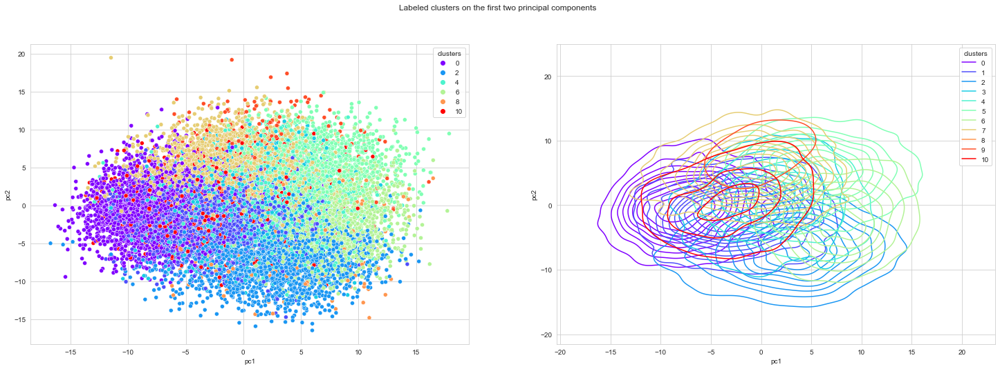

In [45]:
plot_in_2d(df_standardized, clusters_ac)

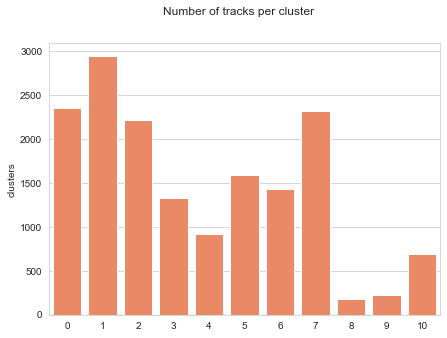

In [46]:
plt.figure(figsize=(7, 5))
sns.barplot(y=clusters_ac.value_counts(), x=clusters_ac.value_counts().index, orient='v', color='coral')
plt.suptitle('Number of tracks per cluster')
plt.show()

In this case we cannot directly measure whether the clusters represent the genre of the tracks since the number of genres is greater than the number of clusters.

# 5. Results and future work
The results from the clustering could be used for creating personalized (targeted) music recommendations.
They could also be used for creating diverse and cohesive playlists, as well as enriching already existing playlists.

TODO:
- Experiments with more clustering methods (including density based), defining custom proximity measures, using different subsets of the audio features...
- Further analysis on the audio features within the clusters estimated from the data (comparison of spectral envelopes, chroma features, noise etc.)